In [1]:
%reload_ext autoreload
%autoreload 2
%matplotlib inline

In [2]:
import sqlite3
import numpy as np
from SlideRunner.dataAccess.database import Database
from tqdm import tqdm
from pathlib import Path
import openslide
import time

In [3]:
from fastai import *
from fastai.vision import *
from fastai.callbacks import *
from random import randint

In [4]:
from data_loader import *
from callbacks.callbacks import BBLossMetrics, BBMetrics, PascalVOCMetric
from helper.object_detection_helper import *
from loss.RetinaNetFocalLoss import RetinaNetFocalLoss
from models.RetinaNet import RetinaNet

In [5]:
path = Path('/data/Datasets/EIPH_WSI/')

database = Database()
database.open(str(path/'EIPH.sqlite'))

size = 512

### At this point you can customize your sampling function 

In [6]:
def sampling_func(y, **kwargs):
    y_label = np.array(y[1])
    h, w = kwargs['size']

    bg_label = [0] if y_label.dtype == np.int64 else ["bg"]
    classes = bg_label + kwargs['classes']
    level_dimensions = kwargs['level_dimensions']
    level = kwargs['level']

    _bg_label_prob = 0.1  # add a backgound label to sample complete random
    _random_offset_scale = 0.5  # up to 50% offset to left and right of frame
    # calc histogram
    sample_probability = np.array([np.count_nonzero(np.array(y_label) == class_id) / len(y_label)
                                   for class_id in classes])

    non_zero_ids = (sample_probability > 0) & (sample_probability < 1)
    sample_probability[non_zero_ids] = 1 - sample_probability[non_zero_ids]
    sample_probability[0] = _bg_label_prob
    # softmax
    non_zero_ids = sample_probability > 0
    xoffset = randint(-w, w) * _random_offset_scale
    yoffset = randint(-h, h) * _random_offset_scale
    sample_probability[non_zero_ids] = np.exp(sample_probability[non_zero_ids]) \
                                       / np.sum(np.exp(sample_probability[non_zero_ids]), axis=0)
    class_id = np.random.choice(classes, 1, p=sample_probability)[0]
    if class_id == bg_label[0]:
        slide_width, slide_height = level_dimensions[level]
        xmin, ymin = randint(int(w / 2 - xoffset), slide_width - w), randint(int(h / 2 - yoffset), slide_height - h)
    else:
        # sample from a completely random image position
        ids = y_label == class_id
        xmin, ymin, xmax, ymax = np.array(y[0])[ids][randint(0, np.count_nonzero(ids) - 1)]

    return int(xmin - w / 2 + xoffset), int(ymin - h / 2 +yoffset)

In [7]:
files = []
lbl_bbox = []

getslides = """SELECT uid, filename FROM Slides"""
for currslide, filename in tqdm(database.execute(getslides).fetchall()):
    database.loadIntoMemory(currslide)

    check = True if 'erliner' in filename else False
    slidetype = 'Berliner Blau/' if check else 'Turnbull Blue/'

    slide_path = path / slidetype / filename

    slide = openslide.open_slide(str(slide_path))
    level = 1#slide.level_count - 1
    level_dimension = slide.level_dimensions[level]
    down_factor = slide.level_downsamples[level]

    classes = {3: 1, 4: 2, 5: 3, 6: 4, 7: 5}#{3: 1, 4: 2, 5: 3, 6: 4, 7: 5} #
    labels, bboxes = [], []
    for id, annotation in database.annotations.items():
        if annotation.labels[0].classId in classes:
            d = 2 * annotation.r / down_factor
            x_min = (annotation.x1 - annotation.r) / down_factor
            y_min = (annotation.y1 - annotation.r) / down_factor
            x_max = x_min + d
            y_max = y_min + d
            label = classes[annotation.labels[0].classId]

            bboxes.append([int(x_min), int(y_min), int(x_max), int(y_max)])
            labels.append(label)

    if len(bboxes) > 0:
        lbl_bbox.append([bboxes, labels])
        # Optional use of the sampling function
        files.append(SlideContainer(file=slide_path, y=[bboxes, labels],
                                    level=level, width=size, height=size, sample_func=sampling_func))  

  0%|          | 0/24 [00:00<?, ?it/s]

Loading DB into memory ...


  4%|▍         | 1/24 [00:00<00:11,  1.95it/s]

Loading DB into memory ...


  8%|▊         | 2/24 [00:02<00:26,  1.18s/it]

Loading DB into memory ...


 12%|█▎        | 3/24 [00:03<00:21,  1.02s/it]

Loading DB into memory ...


 17%|█▋        | 4/24 [00:03<00:18,  1.10it/s]

Loading DB into memory ...


 21%|██        | 5/24 [00:03<00:15,  1.26it/s]

Loading DB into memory ...
Loading DB into memory ...


 29%|██▉       | 7/24 [00:04<00:11,  1.53it/s]

Loading DB into memory ...


 33%|███▎      | 8/24 [00:04<00:09,  1.65it/s]

Loading DB into memory ...


 42%|████▏     | 10/24 [00:05<00:07,  1.91it/s]

Loading DB into memory ...
Loading DB into memory ...


 46%|████▌     | 11/24 [00:05<00:06,  2.02it/s]

Loading DB into memory ...


 54%|█████▍    | 13/24 [00:05<00:05,  2.19it/s]

Loading DB into memory ...
Loading DB into memory ...


 62%|██████▎   | 15/24 [00:06<00:03,  2.43it/s]

Loading DB into memory ...
Loading DB into memory ...


 67%|██████▋   | 16/24 [00:06<00:03,  2.34it/s]

Loading DB into memory ...


 75%|███████▌  | 18/24 [00:07<00:02,  2.45it/s]

Loading DB into memory ...


 79%|███████▉  | 19/24 [00:07<00:01,  2.53it/s]

Loading DB into memory ...
Loading DB into memory ...


 83%|████████▎ | 20/24 [00:07<00:01,  2.63it/s]

Loading DB into memory ...


 92%|█████████▏| 22/24 [00:08<00:00,  2.59it/s]

Loading DB into memory ...
Loading DB into memory ...


100%|██████████| 24/24 [00:09<00:00,  2.48it/s]

Loading DB into memory ...


In [8]:
img2bbox = dict(zip(files, np.array(lbl_bbox)))
get_y_func = lambda o:img2bbox[o]

In [9]:
bs = 64
train_images = 5000
val_images = 50

train_files = list(np.random.choice(files[4:], train_images))
valid_files = list(np.random.choice(files[:4], val_images))

#train_files = list(np.random.choice(files, train_images))
#valid_files = list(np.random.choice(files, val_images))

In [10]:
tfms = get_transforms(do_flip=True,
                      flip_vert=True,
                      #max_rotate=90,
                      max_lighting=0.0,
                      #max_zoom=1.2,
                      max_warp=0.0,
                      p_affine=0.5,
                      p_lighting=0.0,
                      #xtra_tfms=xtra_tfms,
                     )
tfms

([RandTransform(tfm=TfmCrop (crop_pad), kwargs={'row_pct': (0, 1), 'col_pct': (0, 1), 'padding_mode': 'reflection'}, p=1.0, resolved={}, do_run=True, is_random=True),
  RandTransform(tfm=TfmAffine (dihedral_affine), kwargs={}, p=1.0, resolved={}, do_run=True, is_random=True),
  RandTransform(tfm=TfmAffine (rotate), kwargs={'degrees': (-10.0, 10.0)}, p=0.5, resolved={}, do_run=True, is_random=True),
  RandTransform(tfm=TfmAffine (zoom), kwargs={'scale': (1.0, 1.1), 'row_pct': (0, 1), 'col_pct': (0, 1)}, p=0.5, resolved={}, do_run=True, is_random=True)],
 [RandTransform(tfm=TfmCrop (crop_pad), kwargs={}, p=1.0, resolved={}, do_run=True, is_random=True)])

In [11]:
train =  ObjectItemListSlide(train_files, path=path)
valid = ObjectItemListSlide(valid_files, path=path)
item_list = ItemLists(path, train, valid)
lls = item_list.label_from_func(get_y_func, label_cls=SlideObjectCategoryList) #
lls = lls.transform(tfms, tfm_y=True, size=size)
data = lls.databunch(bs=bs, collate_fn=bb_pad_collate_min).normalize()

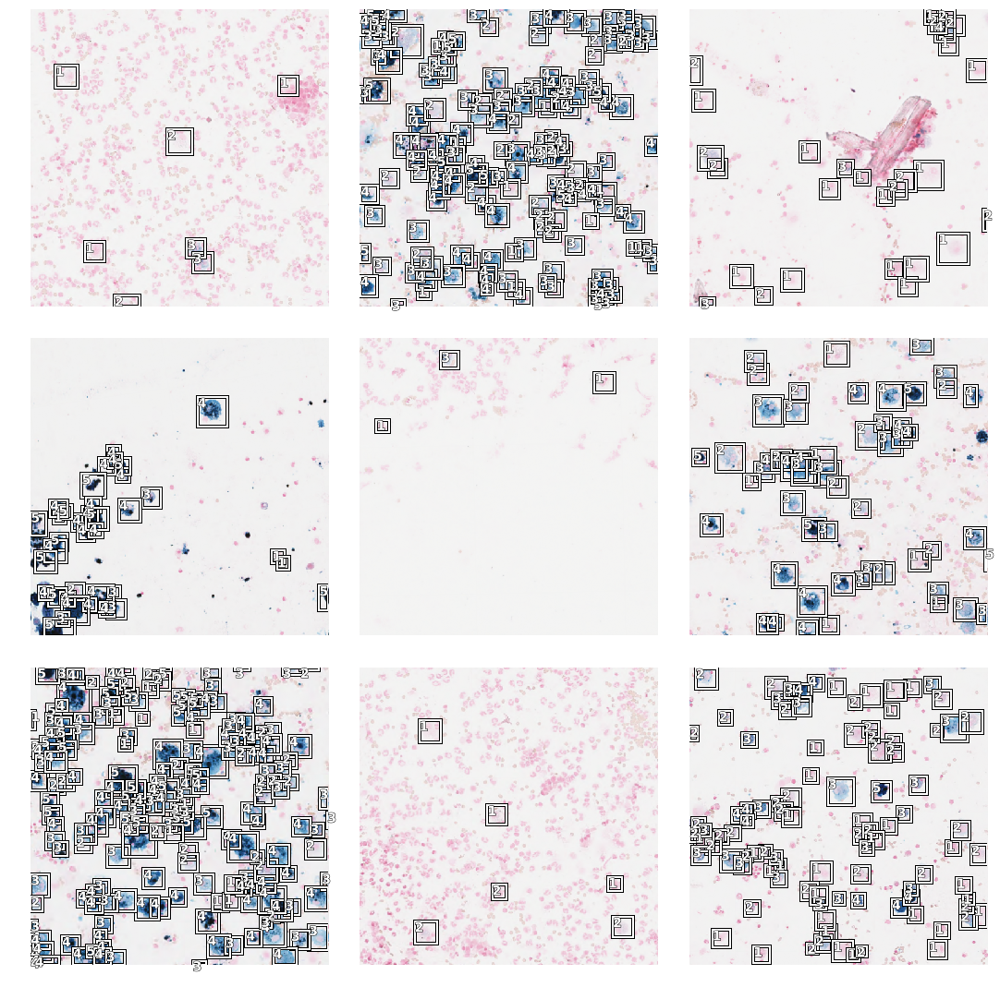

In [12]:
data.show_batch(rows=3, ds_type=DatasetType.Train, figsize=(15,15))

In [ ]:
scale = 2

In [100]:
anchors_32 = create_anchors(sizes=[(32,32)], ratios=[1], scales=[0.35, 0.5, 0.6])

In [101]:
anchors = anchors_32
anchors[:10]

tensor([[-0.9688, -0.9688,  0.0875,  0.0875],
        [-0.9688, -0.9688,  0.1250,  0.1250],
        [-0.9688, -0.9688,  0.1500,  0.1500],
        [-0.9688, -0.9062,  0.0875,  0.0875],
        [-0.9688, -0.9062,  0.1250,  0.1250],
        [-0.9688, -0.9062,  0.1500,  0.1500],
        [-0.9688, -0.8438,  0.0875,  0.0875],
        [-0.9688, -0.8438,  0.1250,  0.1250],
        [-0.9688, -0.8438,  0.1500,  0.1500],
        [-0.9688, -0.7812,  0.0875,  0.0875]])

/home/c.marzahl@de.eu.local/anaconda3/envs/fastai/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


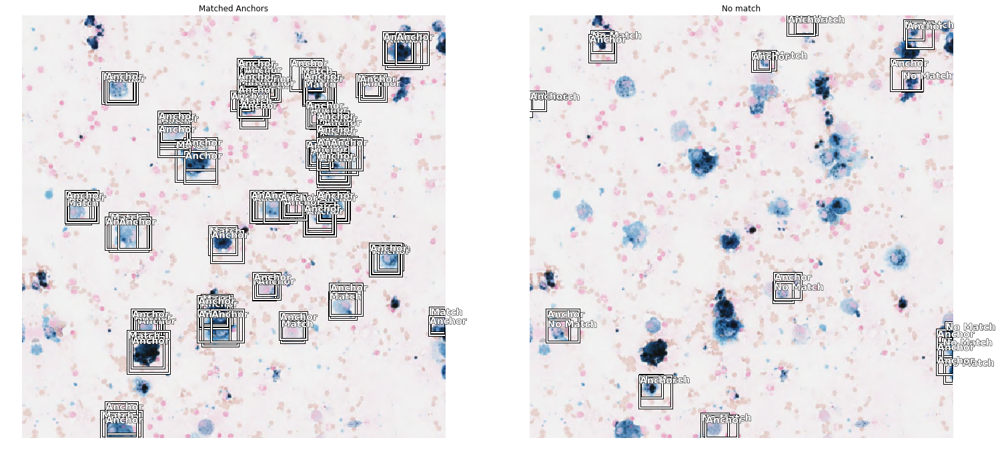

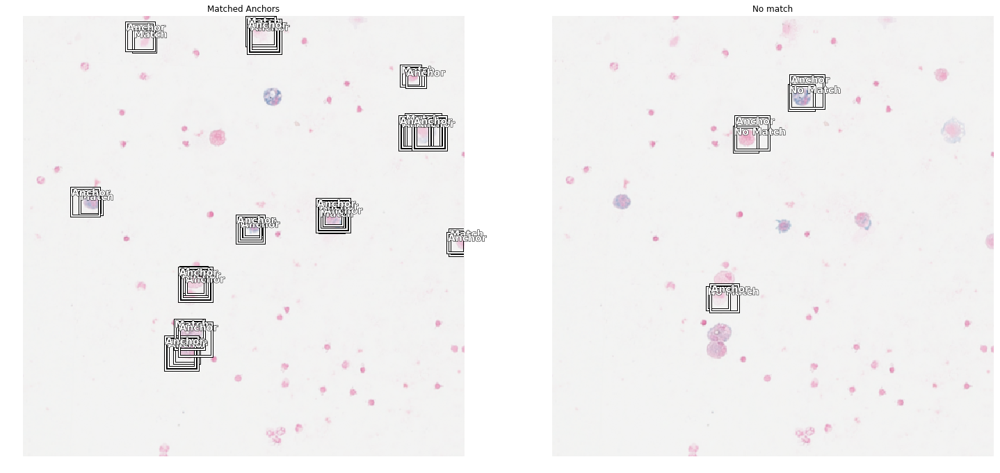

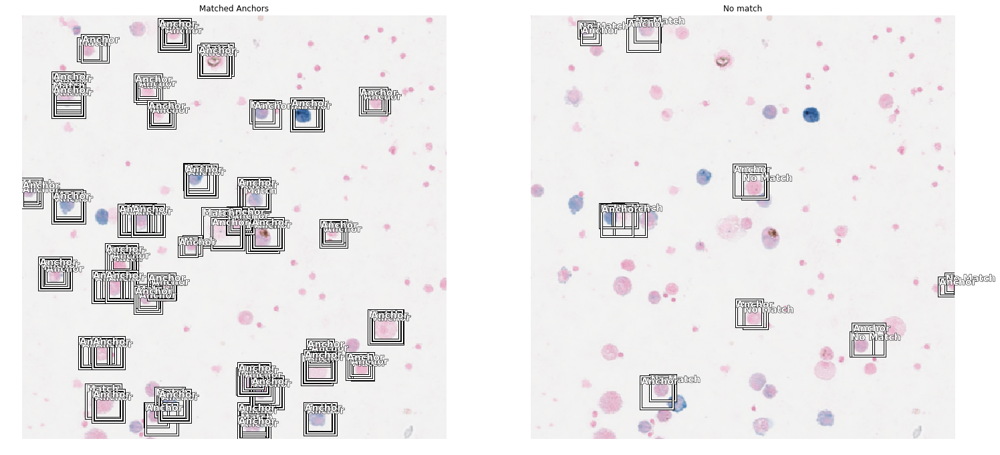

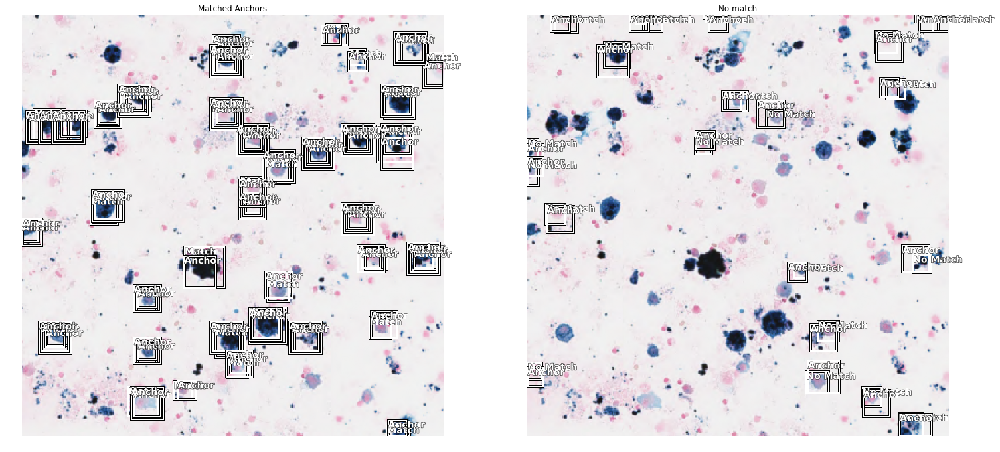

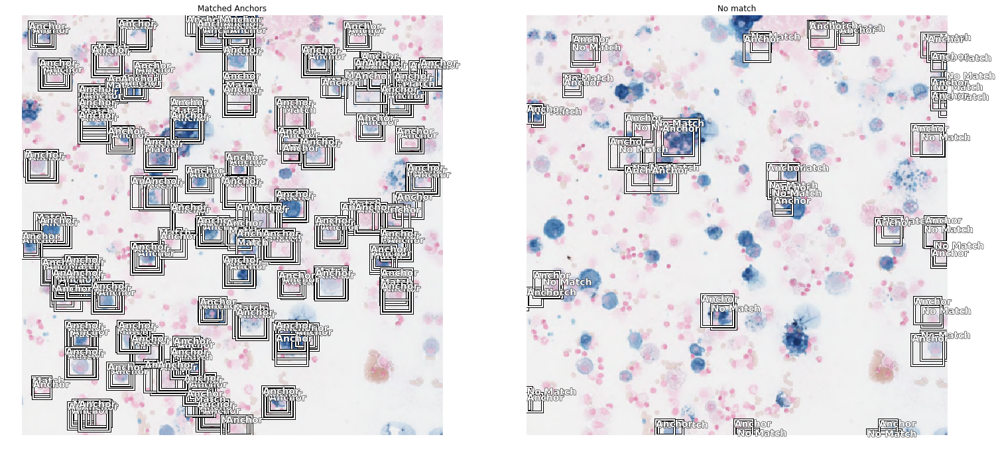

...

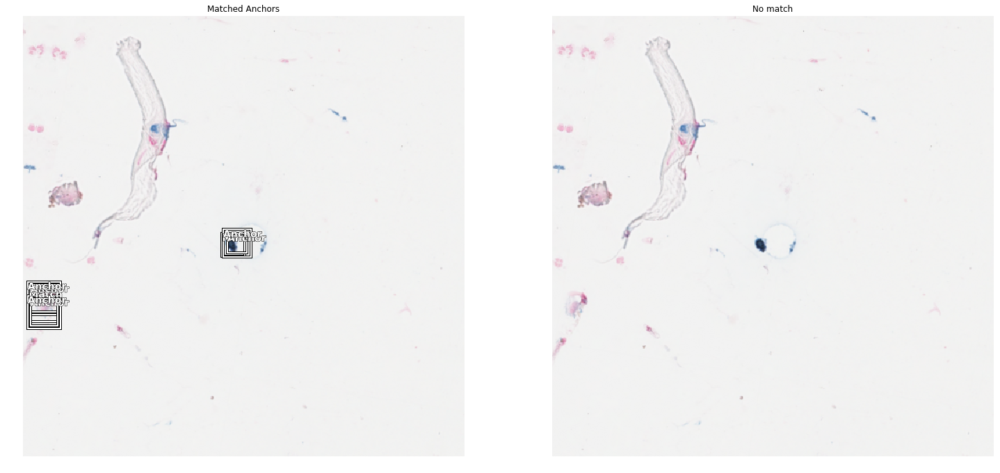

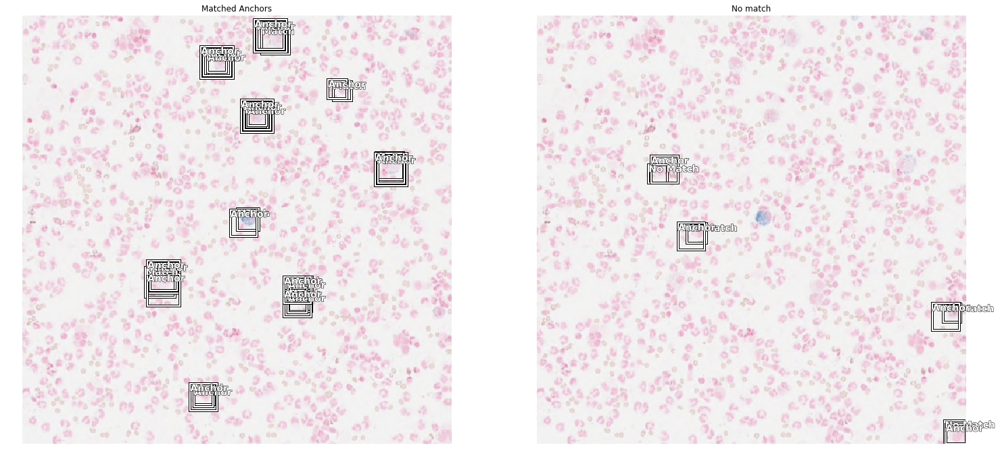

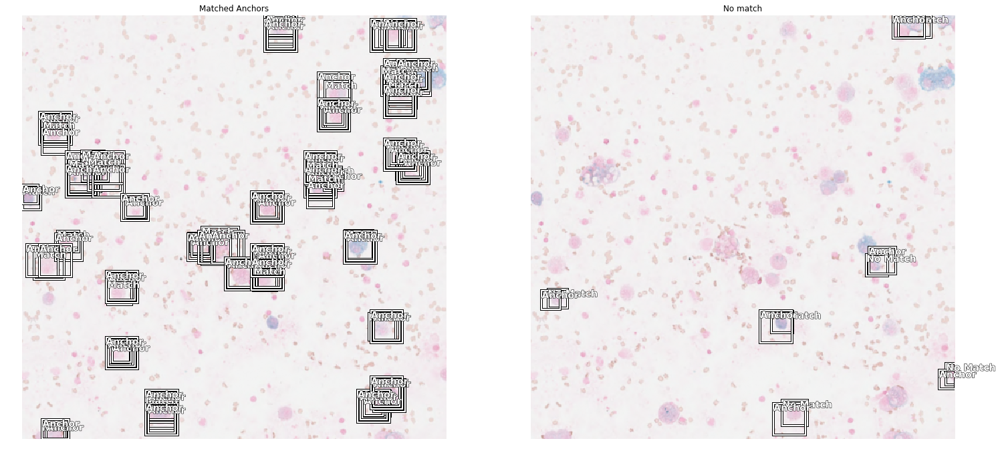

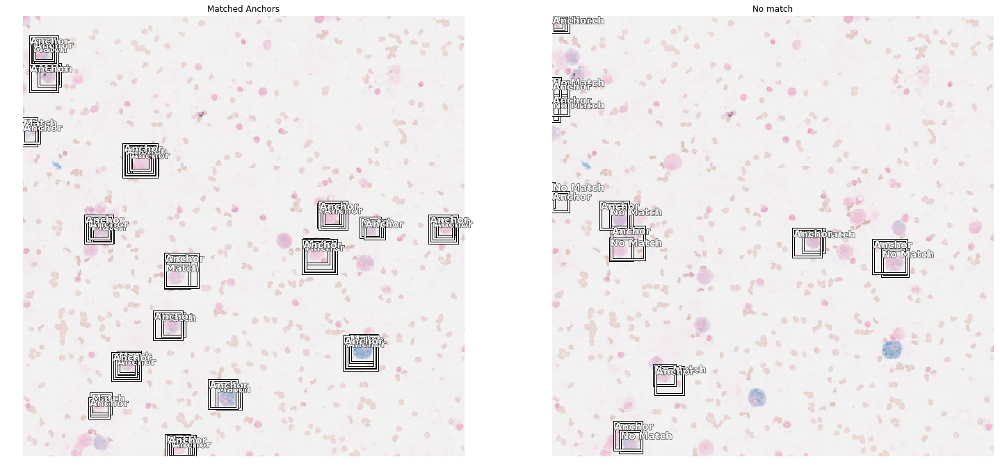

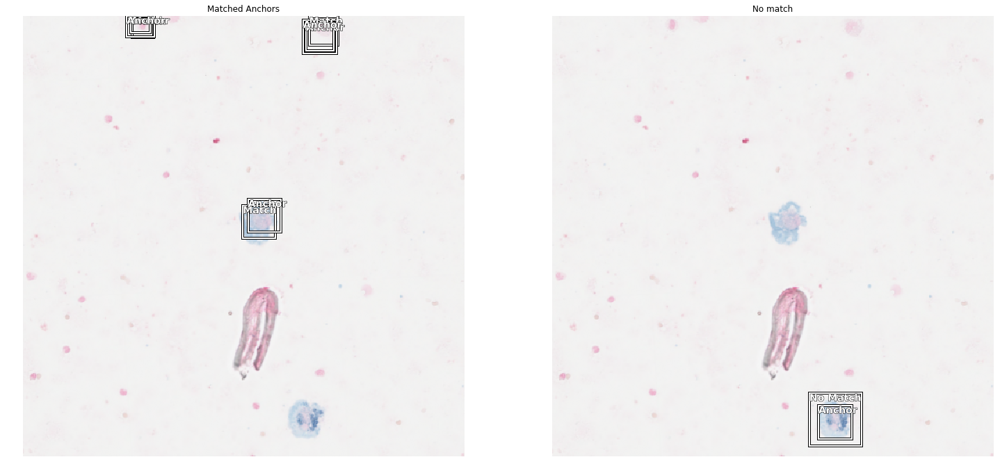

In [102]:
all_boxes, all_labels = show_anchors_on_images(data, anchors, figsize=(25,25))

In [73]:
all_boxes[all_labels == 0]

array([[ 0.992611,  0.308024,  0.014777,  0.081156],
       [ 0.972136,  0.250416,  0.055729,  0.115781],
       [ 0.555459, -0.243673,  0.086662,  0.070635],
       [ 0.497842, -0.258142,  0.106089,  0.086428],
       ...,
       [-0.99945 , -0.405546,  0.0011  ,  0.117556],
       [ 0.002055, -0.48224 ,  0.08464 ,  0.08464 ],
       [-0.188762, -0.68589 ,  0.10725 ,  0.104351],
       [ 0.677765, -0.925522,  0.089342,  0.089342]], dtype=float32)

In [137]:
anchors.shape

torch.Size([768, 4])

In [14]:
anchors

tensor([[-0.9688, -0.9688,  0.0875,  0.0875],
        [-0.9688, -0.9688,  0.1250,  0.1250],
        [-0.9688, -0.9688,  0.1500,  0.1500],
        ...,
        [ 0.9688,  0.9688,  0.0875,  0.0875],
        [ 0.9688,  0.9688,  0.1250,  0.1250],
        [ 0.9688,  0.9688,  0.1500,  0.1500]])

In [164]:
anchors = torch.cat((anchors_32, anchors_16), 0)

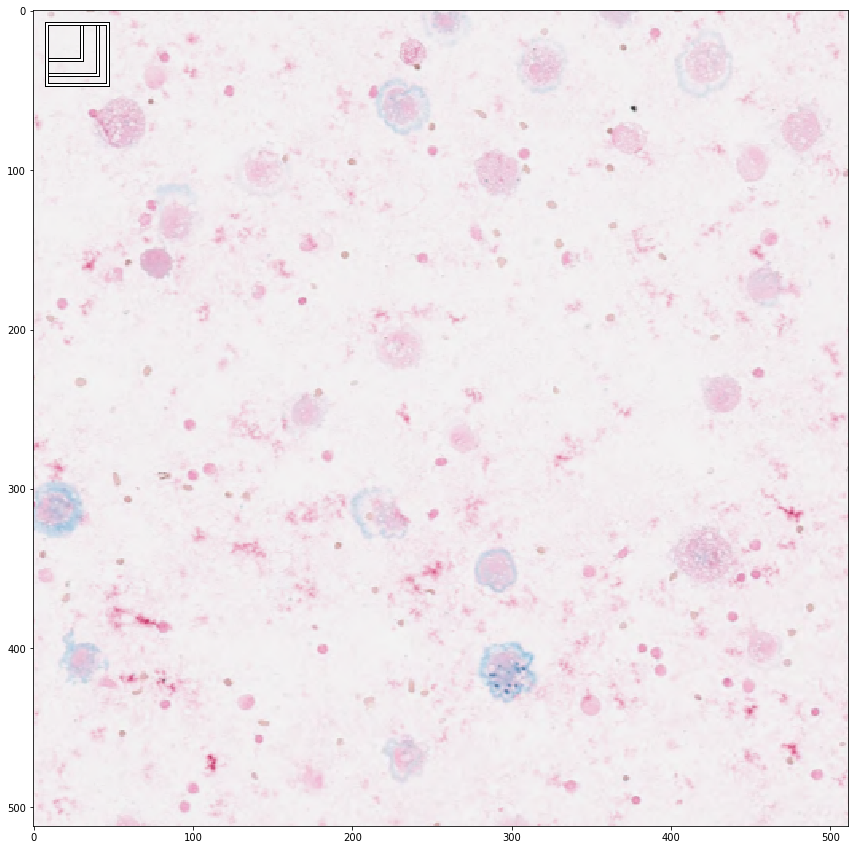

In [45]:
fig,ax = plt.subplots(figsize=(15,15))
ax.imshow(image2np(data.valid_ds[0][0].data))

for i, bbox in enumerate(anchors[:3]):
    bb = bbox.numpy()
    x = (bb[0] + 1) * size / 2 
    y = (bb[1] + 1) * size / 2 
    w = bb[2] * size / 2
    h = bb[3] * size / 2
    
    rect = [x,y,w,h]
    draw_rect(ax,rect)

In [33]:
crit = RetinaNetFocalLoss(anchors)

In [34]:
encoder = create_body(models.resnet18, True, -2)
model = RetinaNet(encoder, n_classes=data.train_ds.c, n_anchors=3, sizes=[32], chs=128, final_bias=-4., n_conv=3)

In [35]:
voc = PascalVOCMetric(anchors, size, [str(i-1) for i in data.train_ds.y.classes[1:]])
learn = Learner(data, model, loss_func=crit, callback_fns=[BBMetrics], #BBMetrics, ShowGraph
                metrics=[voc]
               )

In [36]:
learn.split([model.encoder[6], model.c5top5])
learn.freeze_to(-2)

LR Finder is complete, type {learner_name}.recorder.plot() to see the graph.


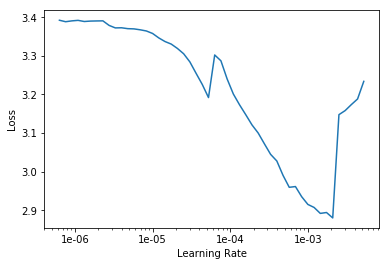

In [17]:
learn.lr_find()
learn.recorder.plot()

In [37]:
learn.fit_one_cycle(3, 1e-3)

epoch,train_loss,valid_loss,pascal_voc_metric,BBloss,focal_loss,AP-0,AP-1,AP-2,AP-3,AP-4,time
0,1.744121,1.529115,0.027510,0.394713,1.134402,0.072526,0.065023,0.000000,0.000000,0.000000,01:56
1,1.056940,0.744228,0.179222,0.263587,0.480641,0.246459,0.320610,0.230051,0.098992,0.000000,01:51
2,0.776630,0.669518,0.200637,0.248849,0.420669,0.303646,0.340323,0.244928,0.114286,0.000000,01:56


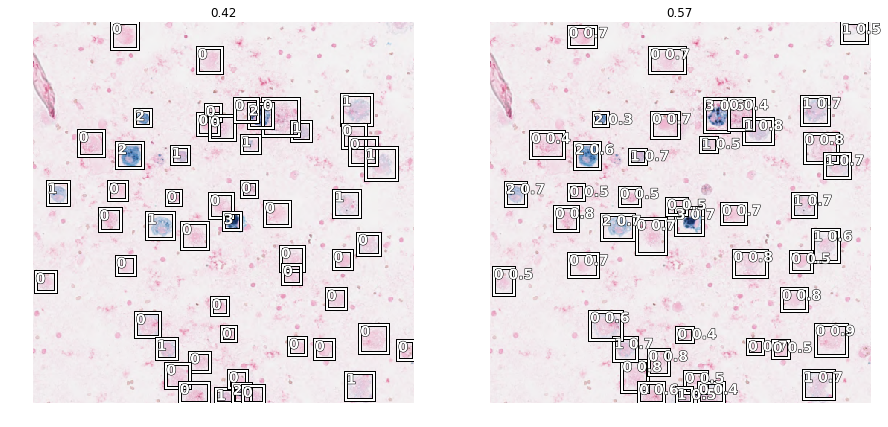

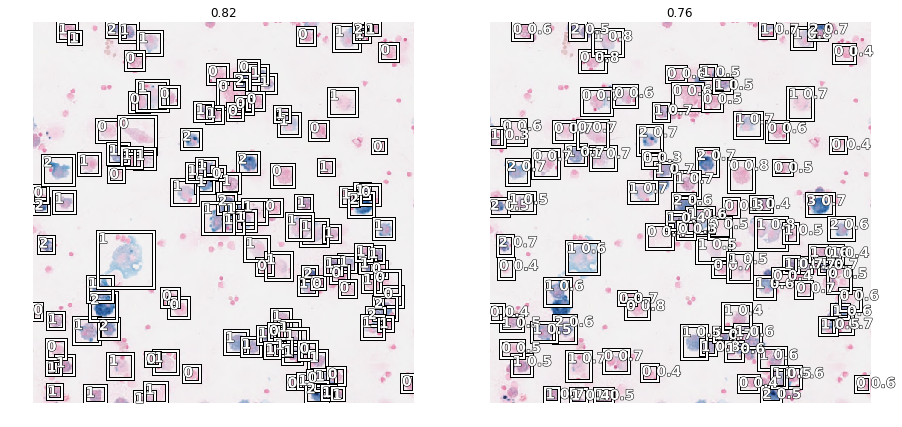

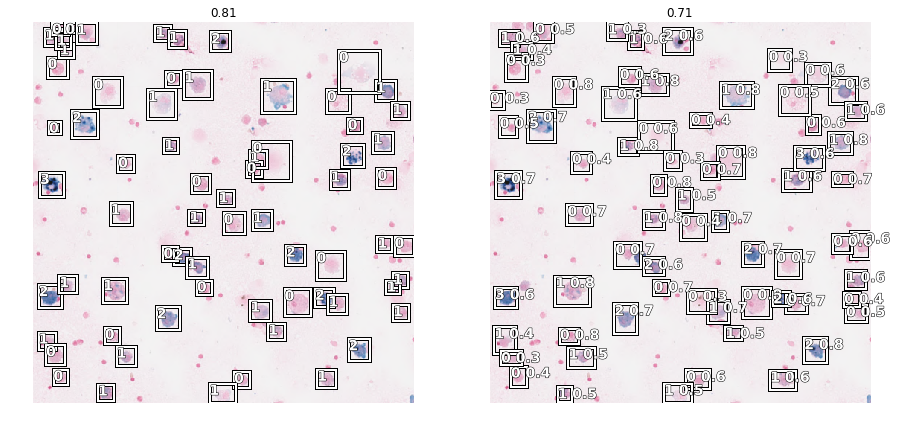

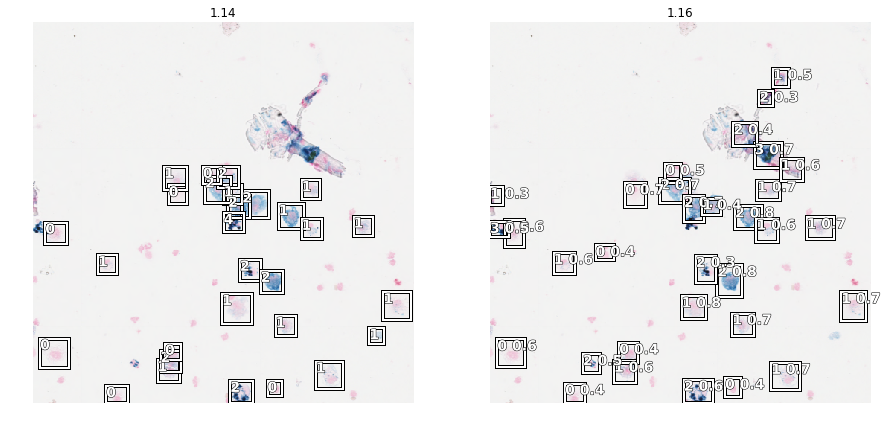

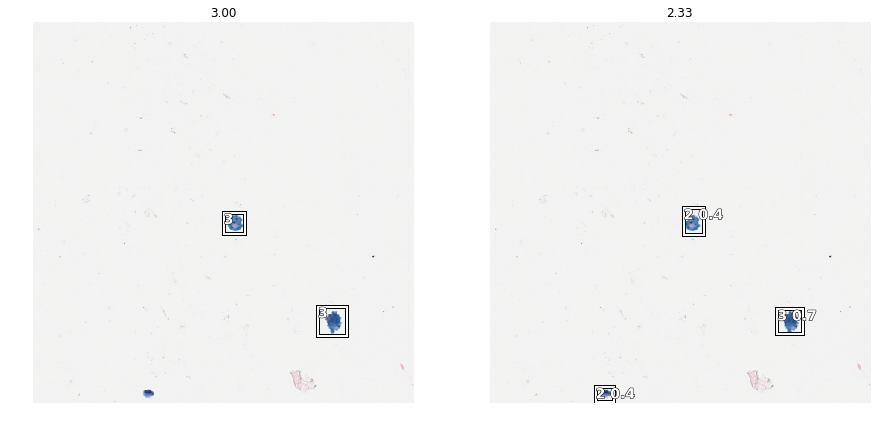

In [53]:
slide_object_result(learn, anchors, detect_thresh=0.3, nms_thresh=0.1, image_count=5)

In [49]:
learn.unfreeze()
learn.fit_one_cycle(10, 1e-4)
#learn.save("pferd_512_1")

epoch,train_loss,valid_loss,pascal_voc_metric,BBloss,focal_loss,AP-0,AP-1,AP-2,AP-3,AP-4,time
0,0.349437,0.381394,0.387091,0.134555,0.246840,0.585731,0.596655,0.430533,0.322538,0.000000,02:29
1,0.354671,0.370969,0.426578,0.137565,0.233405,0.590925,0.623824,0.447285,0.408358,0.062500,01:59
2,0.358044,0.384434,0.424145,0.145813,0.238621,0.627291,0.628436,0.457591,0.407407,0.000000,01:58
3,0.360195,0.386035,0.409531,0.138751,0.247284,0.592078,0.583716,0.391241,0.324072,0.156548,01:58
4,0.350156,0.360796,0.417868,0.128972,0.231825,0.572758,0.659365,0.393283,0.361369,0.102564,02:17
5,0.341167,0.338563,0.483837,0.126567,0.211996,0.646988,0.607855,0.459668,0.319051,0.385621,02:05
6,0.340765,0.356980,0.429835,0.136168,0.220811,0.626432,0.590310,0.562462,0.298541,0.071429,01:59
7,0.333411,0.347342,0.454701,0.134096,0.213246,0.608772,0.642725,0.485051,0.419313,0.117647,02:00
8,0.326577,0.351470,0.455076,0.133970,0.217499,0.658367,0.612695,0.475524,0.436201,0.092593,02:01
9,0.323725,0.299169,0.472390,0.108563,0.190605,0.629632,0.628800,0.514510,0.389010,0.200000,01:57


In [49]:
#learn.save("pferd_1_512")
#learn.export("pferd_1_512")

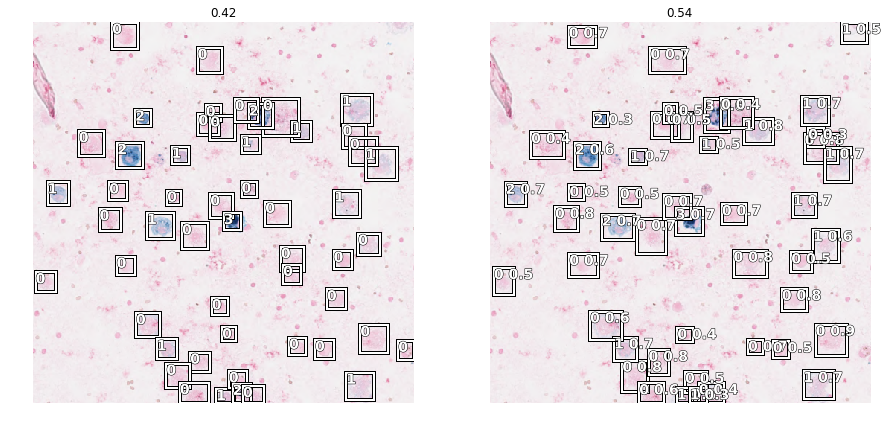

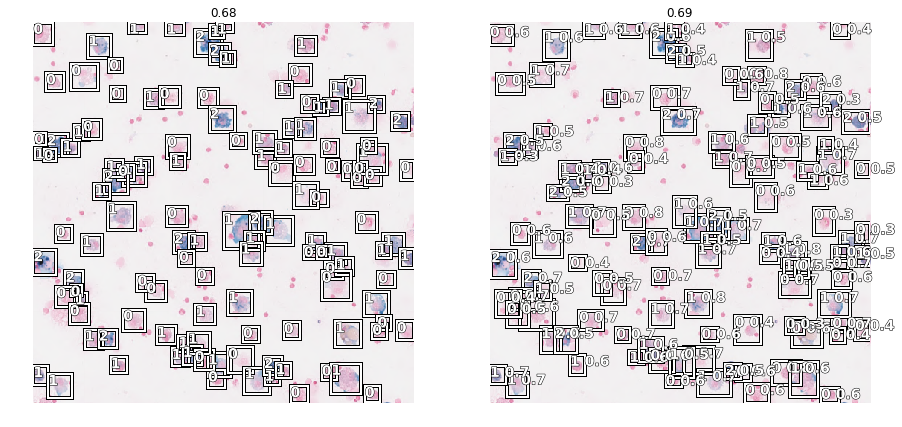

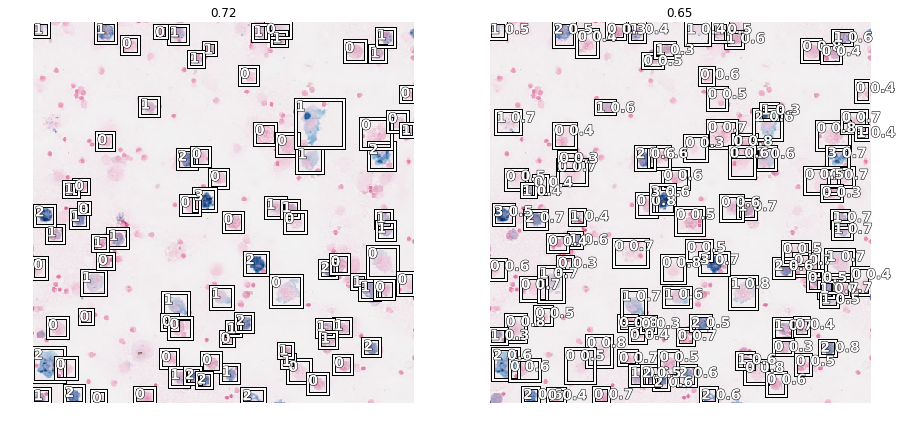

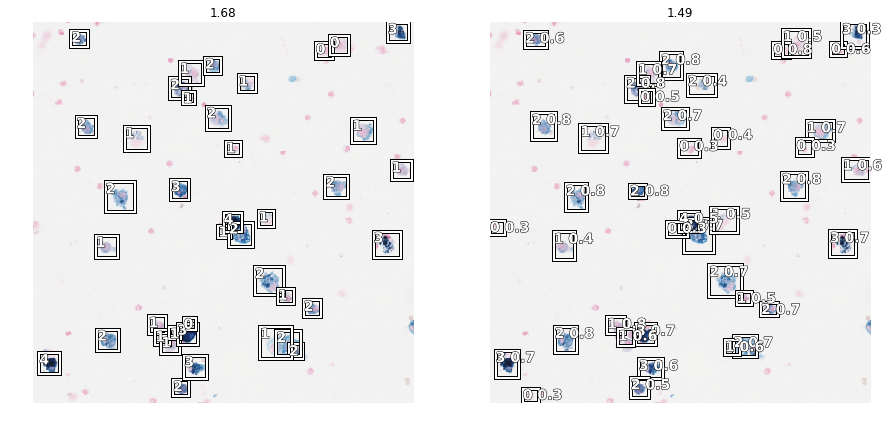

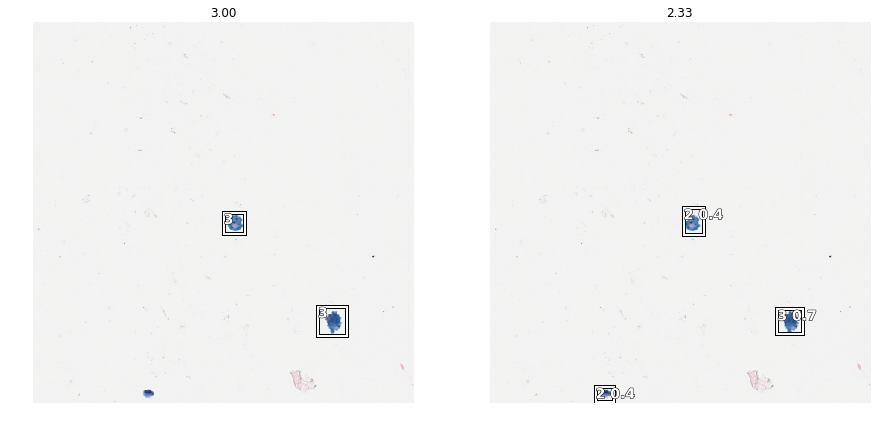

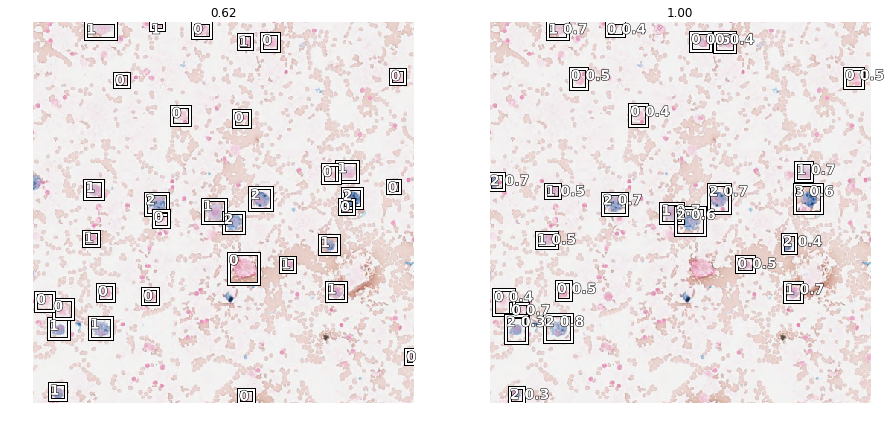

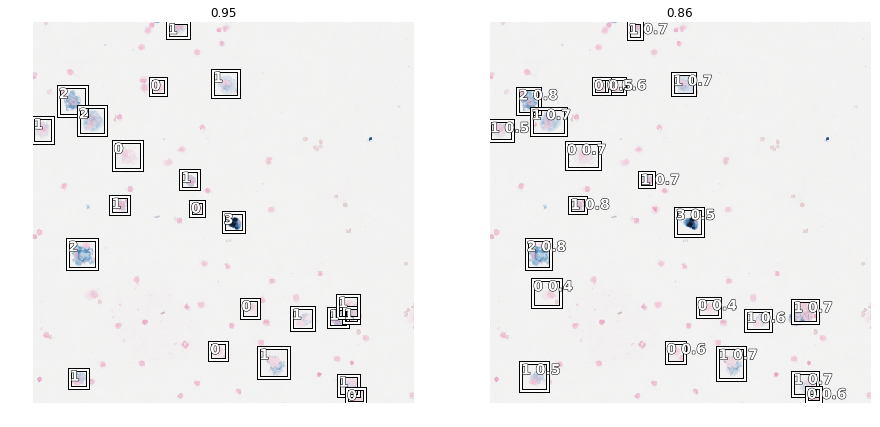

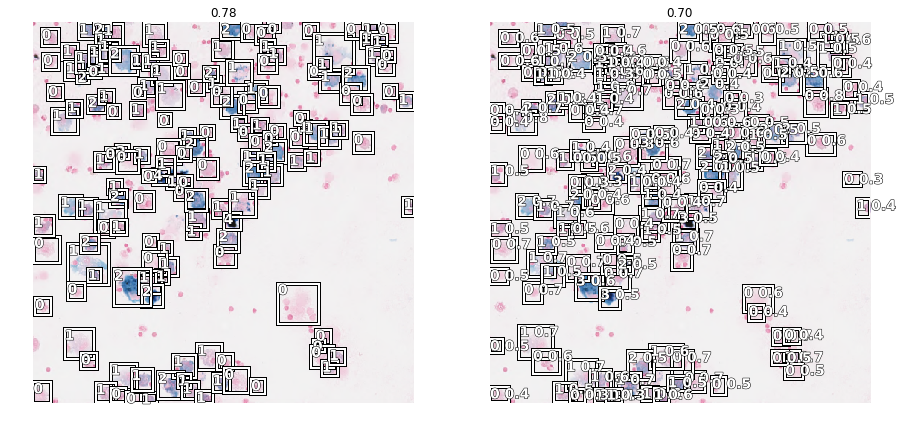

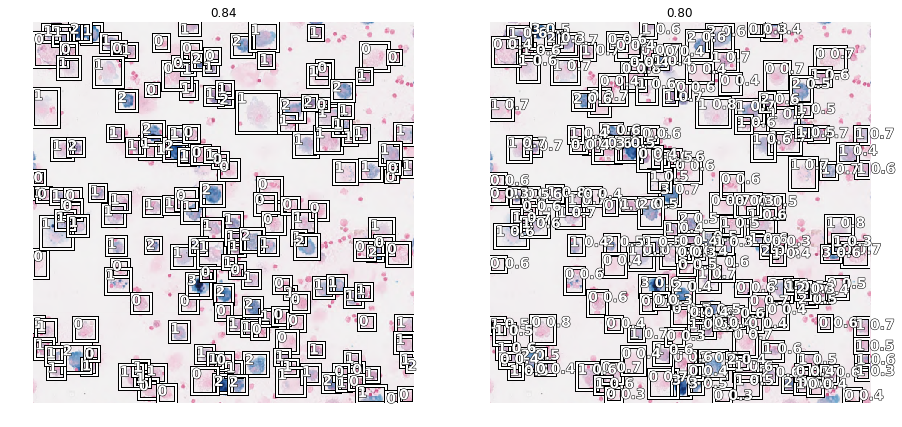

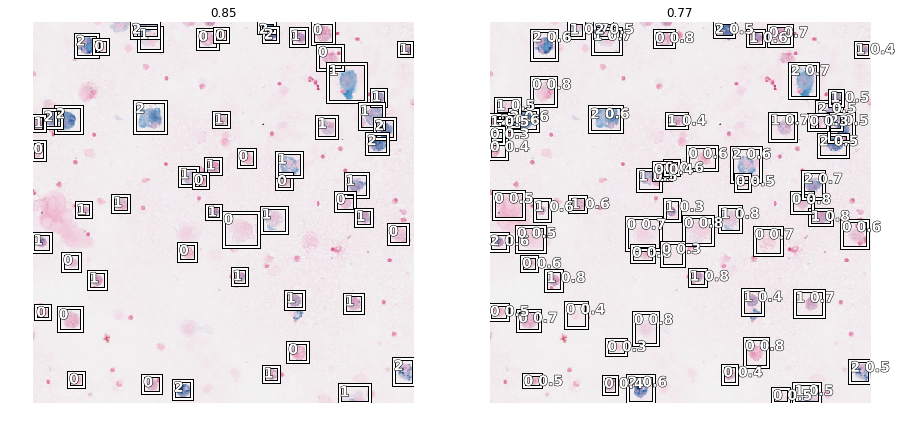

In [55]:
slide_object_result(learn, anchors, detect_thresh=0.3, nms_thresh=0.2, image_count=10)